In [1]:
%matplotlib inline
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab

In [2]:
I = Image.open('/zhome/c5/f/138539/02514-Deep-Learning-In-Computer-Vision/Object_detection/test.png')

In [4]:
from data import *

In [ ]:
import nms 

# use the non-maximum suppression from nms



In [2]:
dataset_path = '/dtu/datasets1/02514/data_wastedetection/'
anns_file_path = dataset_path + '/' + 'annotations.json'

# Read annotations
with open(anns_file_path, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Number of super categories: 28
Number of categories: 60
Number of annotations: 4784
Number of images: 1500


In [3]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab


In [4]:
# Loads dataset as a coco object
coco = COCO(anns_file_path)

loading annotations into memory...
Done (t=0.05s)
creating index...
index created!


In [5]:
coco.dataset

{'info': {'year': 2019,
  'version': None,
  'description': 'TACO',
  'contributor': None,
  'url': None,
  'date_created': '2019-12-19T16:11:15.258399+00:00'},
 'images': [{'id': 0,
   'width': 1537,
   'height': 2049,
   'file_name': 'batch_1/000006.jpg',
   'license': None,
   'flickr_url': 'https://farm66.staticflickr.com/65535/33978196618_e30a59e0a8_o.png',
   'coco_url': None,
   'date_captured': None,
   'flickr_640_url': 'https://farm66.staticflickr.com/65535/33978196618_632623b4fc_z.jpg'},
  {'id': 1,
   'width': 1537,
   'height': 2049,
   'file_name': 'batch_1/000008.jpg',
   'license': None,
   'flickr_url': 'https://farm66.staticflickr.com/65535/47803331152_ee00755a2e_o.png',
   'coco_url': None,
   'date_captured': None,
   'flickr_640_url': 'https://farm66.staticflickr.com/65535/47803331152_19beae025a_z.jpg'},
  {'id': 2,
   'width': 1537,
   'height': 2049,
   'file_name': 'batch_1/000010.jpg',
   'license': None,
   'flickr_url': 'https://farm66.staticflickr.com/65535/

In [8]:

from sklearn.model_selection import train_test_split
imgIds = coco.getImgIds()
train_imgIds, val_imgIds = train_test_split(imgIds, test_size=0.2, random_state=42)



In [17]:
coco.dataset.keys()

dict_keys(['info', 'images', 'annotations', 'scene_annotations', 'licenses', 'categories', 'scene_categories'])

In [19]:
val_imgIds[0:2]

[597, 1235]

In [22]:
img = coco.loadImgs(val_imgIds[0:1])

In [18]:
coco.dataset['categories']

[{'supercategory': 'Aluminium foil', 'id': 0, 'name': 'Aluminium foil'},
 {'supercategory': 'Battery', 'id': 1, 'name': 'Battery'},
 {'supercategory': 'Blister pack', 'id': 2, 'name': 'Aluminium blister pack'},
 {'supercategory': 'Blister pack', 'id': 3, 'name': 'Carded blister pack'},
 {'supercategory': 'Bottle', 'id': 4, 'name': 'Other plastic bottle'},
 {'supercategory': 'Bottle', 'id': 5, 'name': 'Clear plastic bottle'},
 {'supercategory': 'Bottle', 'id': 6, 'name': 'Glass bottle'},
 {'supercategory': 'Bottle cap', 'id': 7, 'name': 'Plastic bottle cap'},
 {'supercategory': 'Bottle cap', 'id': 8, 'name': 'Metal bottle cap'},
 {'supercategory': 'Broken glass', 'id': 9, 'name': 'Broken glass'},
 {'supercategory': 'Can', 'id': 10, 'name': 'Food Can'},
 {'supercategory': 'Can', 'id': 11, 'name': 'Aerosol'},
 {'supercategory': 'Can', 'id': 12, 'name': 'Drink can'},
 {'supercategory': 'Carton', 'id': 13, 'name': 'Toilet tube'},
 {'supercategory': 'Carton', 'id': 14, 'name': 'Other carton'

In [28]:
val_imgIds[0:1]

[597]

In [30]:
imgIds = val_imgIds[:1]
img = coco.loadImgs(imgIds)


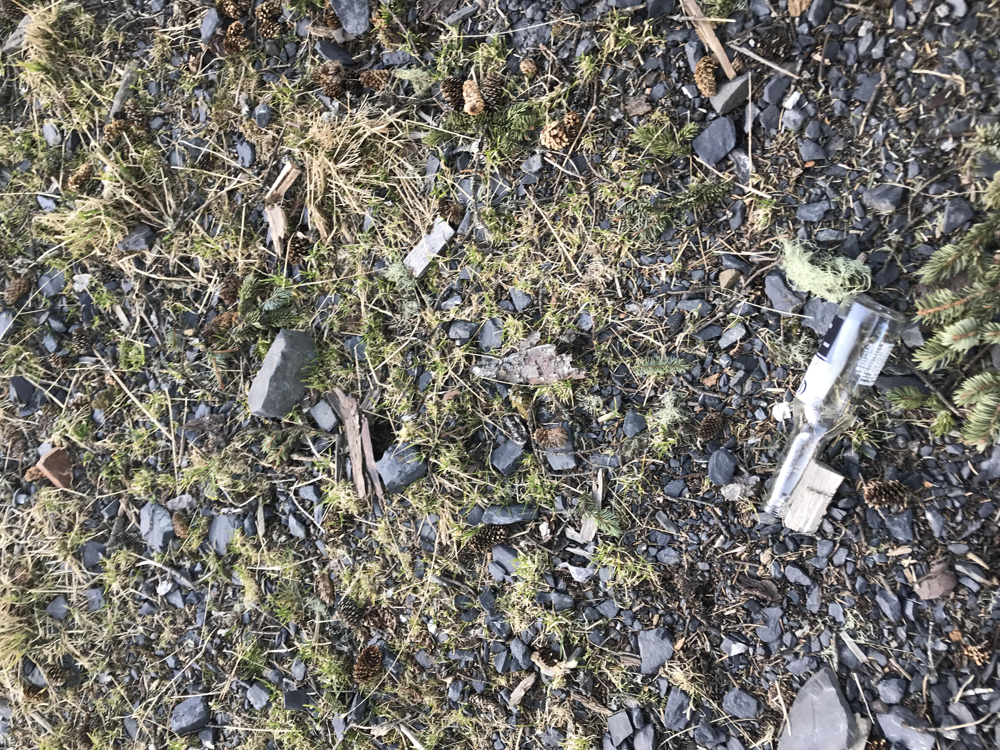

In [33]:
Image.open('/dtu/datasets1/02514/data_wastedetection/' + img[0]['file_name'])

In [34]:
img[0]['id']

597

In [35]:
# coco = COCO(anns_file_path)

# get the differnt categories in coco

coco.getCatIds(catNms = ['Broken glass'])

[9]

In [36]:
# annIds = coco.getAnnIds(imgIds=img[0]['id'], catIds=imgIds, iscrowd=None)
# anns_sel = coco.loadAnns(annIds)


TypeError: COCO.getCatIds() got an unexpected keyword argument 'imgIds'

In [9]:
val_imgIds

[1116,
 1368,
 422,
 413,
 451,
 861,
 1063,
 741,
 1272,
 259,
 888,
 1432,
 712,
 1382,
 70,
 1268,
 1491,
 607,
 433,
 51,
 1199,
 1128,
 1190,
 1249,
 1419,
 432,
 1452,
 1470,
 1234,
 1281,
 1085,
 610,
 1284,
 1041,
 220,
 339,
 423,
 428,
 1105,
 76,
 1391,
 439,
 1336,
 864,
 1080,
 354,
 365,
 309,
 736,
 998,
 621,
 543,
 1140,
 1296,
 554,
 679,
 49,
 490,
 316,
 904,
 636,
 560,
 486,
 67,
 811,
 493,
 310,
 1096,
 1247,
 184,
 306,
 852,
 792,
 289,
 706,
 1329,
 654,
 522,
 461,
 930,
 1034,
 29,
 240,
 798,
 817,
 65,
 601,
 924,
 754,
 926,
 1101,
 247,
 277,
 1402,
 1066,
 479,
 426,
 123,
 1169,
 394,
 985,
 715,
 1134,
 1084,
 497,
 44,
 59,
 1161,
 23,
 874,
 481,
 1324,
 745,
 231,
 124,
 427,
 818,
 168,
 115,
 1088,
 986,
 1395,
 1424,
 415,
 141,
 1233,
 1293,
 762,
 1206,
 462,
 1243,
 78,
 1004,
 1490,
 571,
 15,
 494,
 350,
 999,
 274,
 1191,
 271,
 1473,
 237,
 585,
 1312,
 694,
 1001,
 322,
 782,
 1358,
 1203,
 970,
 1466,
 526,
 1425,
 1170,
 175,
 358,
 4

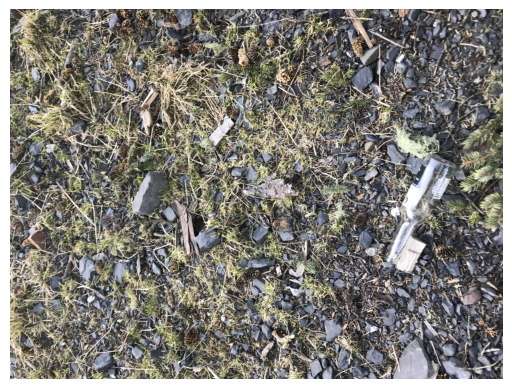

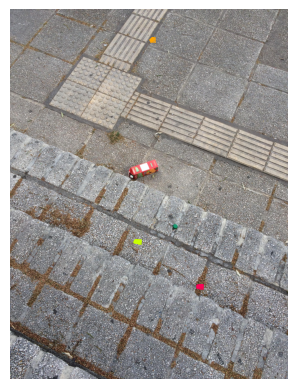

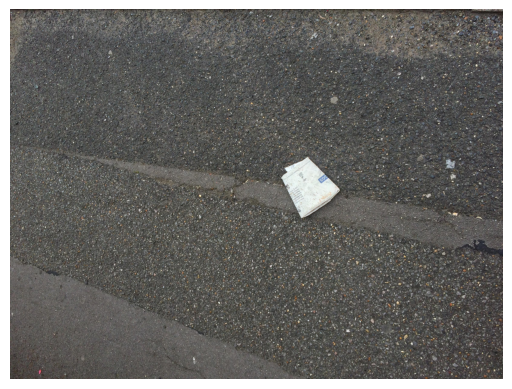

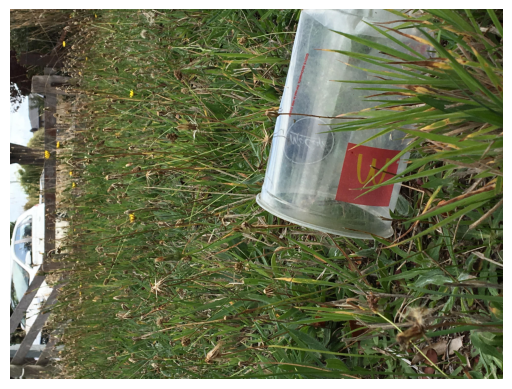

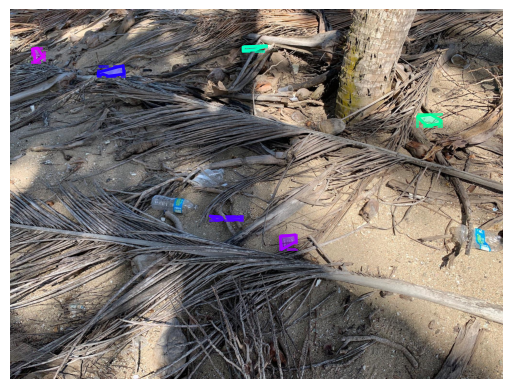

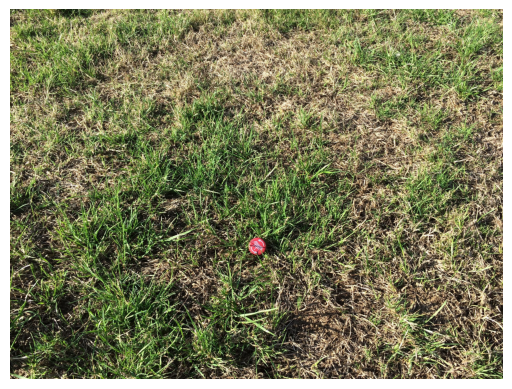

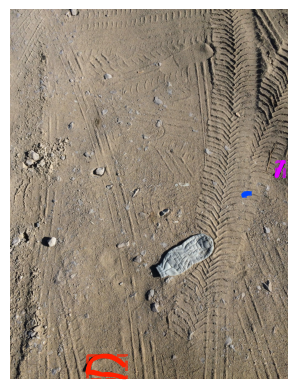

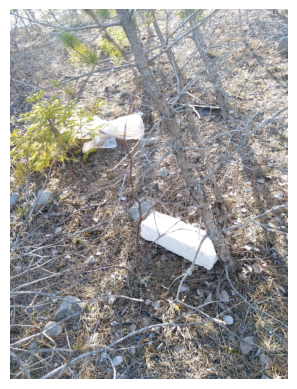

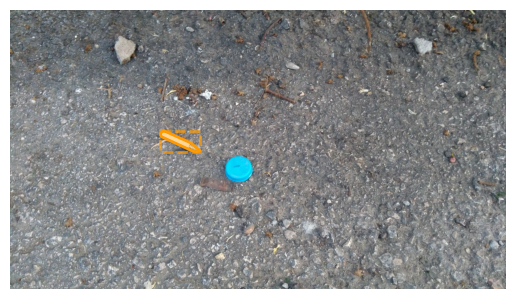

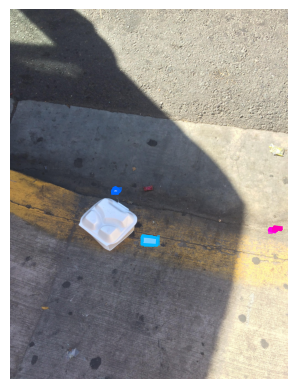

In [13]:
dataset_path = '/dtu/datasets1/02514/data_wastedetection/'
# Select N random images
random.shuffle(val_imgIds)
imgIds = val_imgIds[:10]
imgs = coco.loadImgs(imgIds)

for img in imgs:
    image_path = dataset_path + '/' + img['file_name']
    # Load image
    I = Image.open(image_path)
    
    # # Load and process image metadata
    # if I._getexif():
    #     exif = dict(I._getexif().items())
    #     # Rotate portrait and upside down images if necessary
    #     if orientation in exif:
    #         if exif[orientation] == 3:
    #             I = I.rotate(180,expand=True)
    #         if exif[orientation] == 6:
    #             I = I.rotate(270,expand=True)
    #         if exif[orientation] == 8:
    #             I = I.rotate(90,expand=True)
    
    # Show image
    fig,ax = plt.subplots(1)
    plt.axis('off')
    plt.imshow(I)

    # # Load mask ids
    catIds = val_imgIds
    annIds = coco.getAnnIds(imgIds=img['id'], catIds=catIds, iscrowd=None)
    anns_sel = coco.loadAnns(annIds)
    
    # Show annotations
    for ann in anns_sel:
        color = colorsys.hsv_to_rgb(np.random.random(),1,1)
        for seg in ann['segmentation']:
            poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            ax.add_collection(p)
            p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            ax.add_collection(p)
        [x, y, w, h] = ann['bbox']
        rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                         facecolor='none', alpha=0.7, linestyle = '--')
        ax.add_patch(rect)

    plt.show()
